<a href="https://colab.research.google.com/github/niconicode/AI-Budgie-Identifier/blob/main/ResNet18.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#**Image Classifier with Finetuned Resnet 18 model**

ResNet model trained on imagenet-1k.

Mainly working from the finetuning example presented during the lab session.

1.) Loading the data from google drive, using the preprocessed images from phase 1

2.) Loading the resnet 18 model, adjusting the final layer to have 5 output classes and initializing the weights.

3.) Train and evalute the model. We tried different epochs, learning rates, and batch sizes.
- 10-15 epochs
- learning rate of 5e-5
- Batch size: 16
- Accuracy: ~85%-89%


Increasing the batch size reduces the iterations per epoch, greatly reducing the training time. However, when connected to GPU batch size can be small

#**Load in Testing and Training Data**
- Downloads data from google drive
- y_train and y_test are converted into lists of ints y_train_list and y_test_list

**Mount google drive**

In [ ]:
from google.colab import drive
drive.mount('/content/drive', force_remount=True)

Mounted at /content/drive


**Install and Import Libraries**

In [ ]:
!pip install datasets
!pip install category_encoders
!pip install torch torchvision

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 542.0/542.0 kB 4.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 116.3/116.3 kB 7.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 194.1/194.1 kB 7.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 134.8/134.8 kB 9.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 401.2/401.2 kB 21.7 MB/s eta 0:00:00
  Attempting uninstall: huggingface-hub
    Found existing installation: huggingface-hub 0.20.3
    Uninstalling huggingface-hub-0.20.3:
      Successfully uninstalled huggingface-hub-0.20.3
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 81.9/81.9 kB 1.9 MB/s eta 0:00:00
  Using cached nvidia_cuda_nvrtc_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (23.7 MB)
  Using cached nvidia_cuda_runtime_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (823 kB)
  Using cached nvidia_cuda_cupti_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (14.1 MB)
  Using cached nvidia_cudnn_cu12-8.9.2.26-py3-none-ma

In [ ]:
import torch
import torchvision
import torch.nn as nn
import torch.optim as optim
import datasets
import numpy as np
from torch.utils.data import DataLoader
from torch.utils.data import TensorDataset
from datasets import load_dataset

**Load dataset from google drive**

In [ ]:
import zipfile
import os
zip_file_path = '/content/drive/My Drive/x_train.zip'
#zip_file_path = '/content/drive/MyDrive/AI_Data/x_train.zip'
extract_dir = '/content/'

# Extract the zip file
with zipfile.ZipFile(zip_file_path, 'r') as zip_ref:
    zip_ref.extractall(extract_dir)


zip_file_path = '/content/drive/My Drive/x_test.zip'
#zip_file_path = '/content/drive/MyDrive/AI_Data/x_test.zip'
with zipfile.ZipFile(zip_file_path, 'r') as zip_ref:
    zip_ref.extractall(extract_dir)

**Open H5 Files**

In [ ]:
import h5py
#y_train_h5_path = '/content/drive/My Drive/AI_Data/y_train.h5'
#y_test_h5_path = '/content/drive/My Drive/AI_Data/y_test.h5'

y_train_h5_path = '/content/drive/My Drive/y_train.h5'
y_test_h5_path = '/content/drive/My Drive/y_test.h5'

#y_train_h5_path = '/content/drive/MyDrive/AI_Data/y_train.h5'
#y_test_h5_path = '/content/drive/MyDrive/AI_Data/y_test.h5'

# Open the HDF5 file for reading
with h5py.File(y_train_h5_path, 'r') as hf:
    # Read the dataset
    y_train = hf['y_train'][:]
    # Convert the dataset to a list of strings
    y_train_list = [str(item, 'utf-8') for item in y_train]
    y_train_list = [int(item) for item in y_train]

# Open the HDF5 file for reading
with h5py.File(y_test_h5_path, 'r') as hf:
    # Read the dataset
    y_test = hf['y_test'][:]
    # Convert the dataset to a list of strings
    y_test_list = [str(item, 'utf-8') for item in y_test]
    y_test_list = [int(item) for item in y_test]

# Open the HDF5 file for reading
with h5py.File('x_train.h5', 'r') as hf:
    # Read the dataset
    x_train = hf['x_train'][:]

# Open the HDF5 file for reading
with h5py.File('x_test.h5', 'r') as hf:
    # Read the dataset
    x_test = hf['x_test'][:]

**Visualize images + labels of testset and trainset**

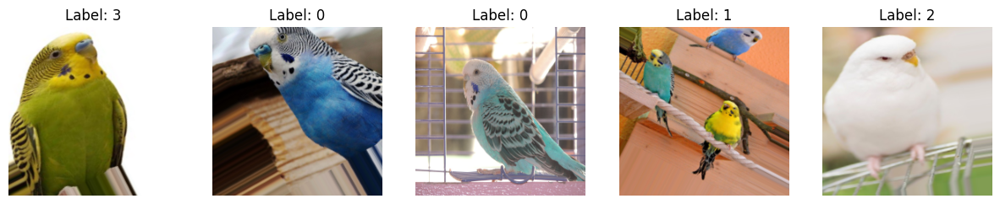

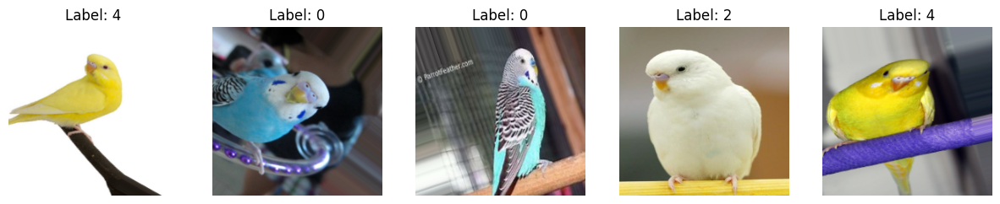

In [ ]:
import matplotlib.pyplot as plt

def visualize_images(images, labels):
    num_images = len(images)
    if num_images == 0:
        print("No images found in the HDF5 file.")
        return
    plt.figure(figsize=(15, 5))
    for i, image in enumerate(images[:5]):  # Visualize only the first 5 images
        plt.subplot(1, 5, i+1)
        plt.imshow(image)
        plt.axis('off')
        plt.title("Label: {}".format(labels[i]))
    plt.show()

visualize_images(x_test, y_test_list)
visualize_images(x_train, y_train_list)

#**Create Dataloaders**

- batch_size can be adjusted here
- Creates dataloaders for training and testing data from x_train and y_train_list, and x_test and y_test_list

**Train Dataset**

In [ ]:
batch_size = 16

# convert y train to a long tensor
y_train_tensor = torch.LongTensor(y_train_list)

# Convert x train to tensor and transpose so that the dimensions channels are in
# the correct order
x_train_tensor = torch.Tensor(x_train)
x_train_tensor = torch.transpose(x_train_tensor, 1, 3)

# Print shapes of tensors to check that they are compatible
print(f"y_train_tensor shape: {y_train_tensor.shape}")
print(f"x_train_tensor shape: {x_train_tensor.shape}")

# Create a TensorDataset
train_dataset = TensorDataset(x_train_tensor, y_train_tensor)

# Create a DataLoader
trainloader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)

y_train_tensor shape: torch.Size([493])
x_train_tensor shape: torch.Size([493, 3, 224, 224])


**Visualize x_train_tensor**

Check the images in x train tensor to make sure it was created correctly

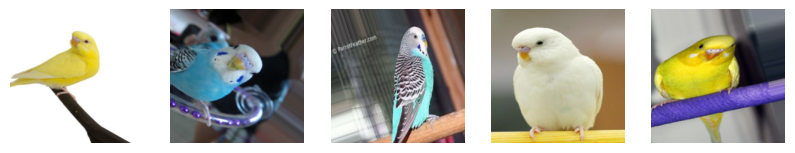

In [ ]:
import matplotlib.pyplot as plt

# Select the first 5 images
images = x_train_tensor[:5]

# Create a figure with a single row and 5 columns
fig, axes = plt.subplots(1, 5, figsize=(10, 5))

# Plot each image on its own subplot
for i, image in enumerate(images):
    image = image.permute(2, 1, 0)
    axes[i].imshow(image)
    axes[i].axis('off')

# Show the plot
plt.show()

**Test Dataset**

In [ ]:
# Convert to tensor
y_test_tensor = torch.LongTensor(y_test_list)

# Convert to tensor and transpose
x_test_tensor = torch.Tensor(x_test)
x_test_tensor = torch.transpose(x_test_tensor, 1, 3)

print(f"y_test_tensor shape: {y_test_tensor.shape}")
print(f"x_test_tensor shape: {x_test_tensor.shape}")

# Create a TensorDataset
test_dataset = TensorDataset(x_test_tensor, y_test_tensor)

# Create a DataLoader
testloader = DataLoader(test_dataset, batch_size=batch_size)

y_test_tensor shape: torch.Size([212])
x_test_tensor shape: torch.Size([212, 3, 224, 224])


**Visualize x_test_tensor**

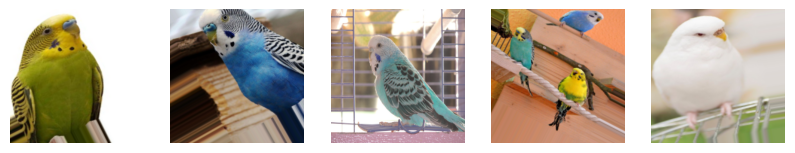

In [ ]:
import matplotlib.pyplot as plt

# Select the first 5 images
images = x_test_tensor[:5]

# Create a figure with a single row and 5 columns
fig, axes = plt.subplots(1, 5, figsize=(10, 5))

# Plot each image on its own subplot
for i, image in enumerate(images):
    image = image.permute(2, 1, 0)
    axes[i].imshow(image)
    axes[i].axis('off')

# Show the plot
plt.show()

#**Load Model**

load resnet 18 model
- Adjust final layer of model to have 5 output classes
- Initialize weights

In [ ]:
import torch
import torchvision
import torch.nn as nn

# Define the model

finetune_net = torchvision.models.resnet18(pretrained=True)
finetune_net.fc = nn.Linear(finetune_net.fc.in_features, 5)     # 5 classes
nn.init.xavier_uniform_(finetune_net.fc.weight);

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


#**Training and Testing Functions**
Training loop with functions to set device, evaluation with a confusion matrix, visualization of evaluated images, and fine tuning where loss, optimizer, etc. can be changed

**Function to set device**

In [ ]:
def try_all_gpus():
    """Return all available GPUs, or [cpu()], if no GPU exists."""
    if torch.cuda.is_available():
        devices = [torch.device(f'cuda:{i}') for i in range(torch.cuda.device_count())]
        return devices
    else:
        return [torch.device('cpu')]

**Training Loop**

In [ ]:
import time

def train_net(net, train_iter, test_iter, loss_fn, optimizer, num_epochs, devices):
    """Train and evaluate the network on multiple devices."""
    # Send the model to the device (multi-GPU or single GPU/CPU)
    net = nn.DataParallel(net, device_ids=devices).to(devices[0])

    # Training loop
    for epoch in range(num_epochs):
        net.train()                                    # Set the model to training mode
        train_loss_sum, n, start = 0.0, 0, time.time() # Initialize variables
        for X, y in train_iter:                        #
            X, y = X.to(devices[0]), y.to(devices[0])  # Move data to the device
            optimizer.zero_grad()                      # Zero the gradients
            y_hat = net(X)                             # Forward pass, y_hat is predicted labels
            loss = loss_fn(y_hat, y)                   # Compute loss by passing predicted and true labels to the loss function
            loss.backward()                            # Backward pass
            optimizer.step()                           # Update the model parameters
            train_loss_sum += loss.item()
            n += y.shape[0]

        # Evaluate the network
        print(f"Epoch {epoch+1}/{num_epochs}:")           # Current epoch
        evaluate_with_confusion(net, test_iter, devices)  # Evaluate with Confusion matrix
        print(f"Loss: {train_loss_sum / n:.3f}")          # Print loss
        print(f'Time: {time.time() - start:.1f} sec')     # Print time
        print("="*30)

**Evaluate Accuracy** by comparing the predicted classes (y_hat) to the actual classes (y) and seeing how many the model got right.

- This was the original method for evaluation from the fine tuning example. However, we don't use this in our model. Instead we use a confusion matrix.

In [ ]:
def evaluate_accuracy(net, data_iter, devices):
    """Evaluate accuracy of a model on the given data set."""
    net.eval()  # Set the model to evaluation mode
    acc_sum, n = 0.0, 0
    with torch.no_grad():
        for X, y in data_iter:
            X, y = X.to(devices[0]), y.to(devices[0])
            y_hat = net(X)
            acc_sum += (y_hat.argmax(dim=1) == y).float().sum().item()
            n += y.shape[0]
    #plot_images(X.cpu().numpy(), y.cpu().numpy(), y_hat.argmax(dim=1).cpu().numpy())

    return acc_sum / n

**Evaluate with Confusion Matrix**
- Plots 5 random test images with true and predicted labels to visualize accuracy

- Confusion matrix shows the number of true positivies, true negatives, false positives, and false negatives for the 5 classes

- Accuracy shows how much of the data was correctly classified

- Precision shows the percentage of the poisitve data points that were actually positive

- Recall shows the percentage of the positive data points that were correctly classified

- F1 score is the harmonic mean of precision and recall. Harmonic mean is used instead of the arithmetic mean because it penalizes extreme values more heavily. This means that a model with a high precision but low recall will have a lower F1 score than a model with a more balanced precision and recall.

In [ ]:
from sklearn.metrics import confusion_matrix, accuracy_score, precision_score, recall_score, f1_score

# Function to calculate metrics using true and predicted labels
def calculate_metrics(true_labels, predicted_labels):
  predicted_labels = torch.tensor(predicted_labels).argmax(dim=1).cpu().numpy()

  confusion = confusion_matrix(true_labels, predicted_labels)
  accuracy = accuracy_score(true_labels, predicted_labels)
  precision = precision_score(true_labels, predicted_labels, average='weighted')
  recall = recall_score(true_labels, predicted_labels, average='weighted')
  f1 = f1_score(true_labels, predicted_labels, average='weighted')
  return confusion, accuracy, precision, recall, f1

def evaluate_with_confusion(net, data_iter, devices):
    true_labels = []
    predicted_labels = []
    net.eval()  # Set the model to evaluation mode
    acc_sum, n = 0.0, 0
    with torch.no_grad():
        for X, y in data_iter:
            X, y = X.to(devices[0]), y.to(devices[0])
            y_hat = net(X)

            true_labels.extend(y.cpu().numpy())
            predicted_labels.extend(y_hat.cpu().numpy())

            # Plot 1 image for every batch with true and predicted labels
            #plot_images(X.cpu().numpy(), y.cpu().numpy(), y_hat.argmax(dim=1).cpu().numpy())

    # Calculate metrics
    confusion, accuracy, precision, recall, f1 = calculate_metrics(true_labels, predicted_labels)

    # Print metrics
    print(f"Confusion Matrix:\n{confusion}")
    print(f"Accuracy: {accuracy:.4f}")
    print(f"Precision: {precision:.4f}")
    print(f"Recall: {recall:.4f}")
    print(f"F1 Score: {f1:.4f}")

**Visualize evaluated images**
- randomly select test images and display them along with their true and predicted labels

In [ ]:
import random

def plot_images(images, labels, predictions, num_images=1):

  random_indices = random.sample(range(len(images)), min(len(images), num_images))
  selected_images = images[random_indices]
  selected_labels = labels[random_indices]
  selected_predictions = predictions[random_indices]

  plt.figure(figsize=(2, 2))
  for i in range(num_images):
    plt.subplot(1, num_images, i + 1)
    plt.xticks([])
    plt.yticks([])
    plt.grid(False)
    plt.imshow(selected_images[i].transpose(2, 1, 0))
    plt.xlabel(f"Predicted: {selected_predictions[i]}, True: {selected_labels[i]}")
  plt.show()

**Fine tuning**

In [ ]:
def train_fine_tuning(net, learning_rate, batch_size=32, num_epochs=10,
                      param_group=True):
    train_iter = trainloader
    test_iter = testloader
    devices = try_all_gpus()
    loss = nn.CrossEntropyLoss(reduction="sum")
    #if param_group:
    #    params_1x = [param for name, param in net.named_parameters()
    #         if name not in ["fc.weight", "fc.bias"]]
    #    trainer = torch.optim.SGD([{'params': params_1x},
    #                               {'params': net.fc.parameters(),
    #                                'lr': learning_rate * 10}],
    #                            lr=learning_rate, weight_decay=0.001)

    trainer = torch.optim.Adam(net.parameters(), lr=learning_rate)
    #trainer = torch.optim.RMSprop(net.parameters(), lr=learning_rate, momentum=0.9)
    #else:
    #    trainer = torch.optim.SGD(net.parameters(), lr=learning_rate,
    #                              weight_decay=0.001)
    train_net(net, train_iter, test_iter, loss, trainer, num_epochs, devices)

#**Training Runs**

**RUN LOAD MODEL** before each train_fine_tuning call

- Currently model does best with around 10-15 epochs, reaching an accuracy of ~90-94%
- 1 epoch takes roughly 2 seconds using GPU
- Dataloaders have batch sizes of 64, need to adjust batch_size variable before creating dataloaders in "Load in Testing and Training Data" under Train Dataset

## Test run 1

Epoch 1/15:


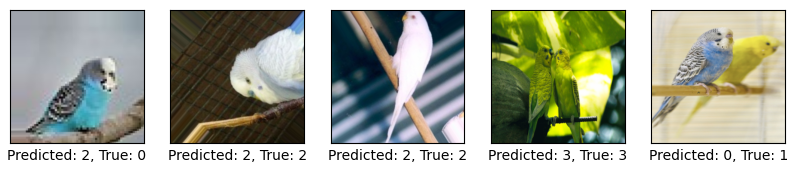

<ipython-input-16-255db1ea2a51>:5: UserWarning: Creating a tensor from a list of numpy.ndarrays is extremely slow. Please consider converting the list to a single numpy.ndarray with numpy.array() before converting to a tensor. (Triggered internally at ../torch/csrc/utils/tensor_new.cpp:275.)
  predicted_labels = torch.tensor(predicted_labels).argmax(dim=1).cpu().numpy()


Confusion Matrix:
[[21  4 15  2  1]
 [13 15  7  4  5]
 [ 6  2 21  1  5]
 [ 4  6  3 18  3]
 [ 5  3  4  5 19]]
Accuracy: 0.4896
Precision: 0.5013
Recall: 0.4896
F1 Score: 0.4881
Time: 4.1 sec
Epoch 2/15:


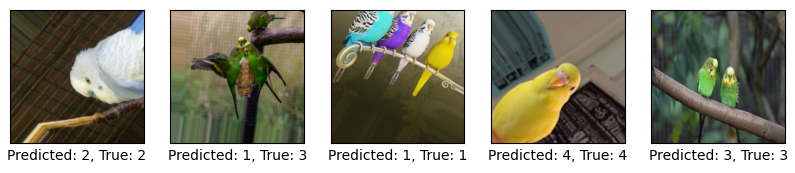

Confusion Matrix:
[[20  9 11  2  1]
 [ 7 25  5  6  1]
 [ 0  3 30  1  1]
 [ 1  5  2 26  0]
 [ 0  4  2  8 22]]
Accuracy: 0.6406
Precision: 0.6660
Recall: 0.6406
F1 Score: 0.6370
Time: 2.0 sec
Epoch 3/15:


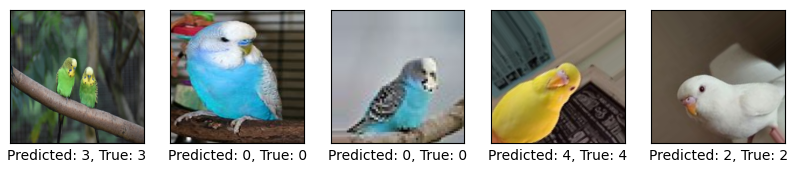

Confusion Matrix:
[[21 10  7  5  0]
 [ 6 25  3  9  1]
 [ 0  2 32  1  0]
 [ 0  4  0 30  0]
 [ 0  3  1 10 22]]
Accuracy: 0.6771
Precision: 0.7160
Recall: 0.6771
F1 Score: 0.6734
Time: 2.2 sec
Epoch 4/15:


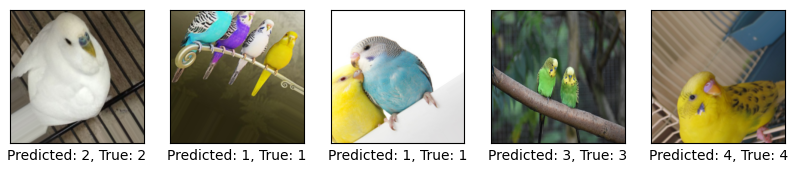

Confusion Matrix:
[[23 13  7  0  0]
 [ 5 35  2  1  1]
 [ 0  4 31  0  0]
 [ 1 12  0 21  0]
 [ 0  8  1  3 24]]
Accuracy: 0.6979
Precision: 0.7556
Recall: 0.6979
F1 Score: 0.7037
Time: 2.0 sec
Epoch 5/15:


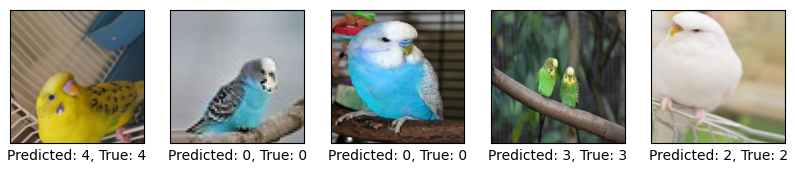

Confusion Matrix:
[[31 10  2  0  0]
 [ 6 33  2  2  1]
 [ 0  3 32  0  0]
 [ 1  6  0 27  0]
 [ 0  2  0  4 30]]
Accuracy: 0.7969
Precision: 0.8111
Recall: 0.7969
F1 Score: 0.8007
Time: 2.1 sec
Epoch 6/15:


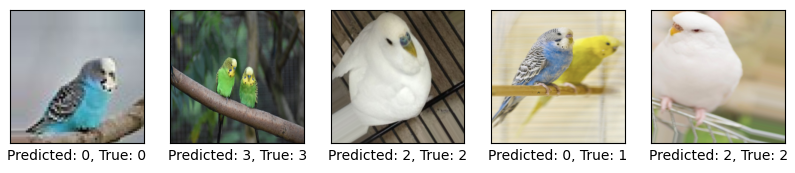

Confusion Matrix:
[[33  4  5  0  1]
 [ 9 24  2  7  2]
 [ 0  0 34  1  0]
 [ 0  3  0 31  0]
 [ 0  0  0  3 33]]
Accuracy: 0.8073
Precision: 0.8071
Recall: 0.8073
F1 Score: 0.8000
Time: 2.2 sec
Epoch 7/15:


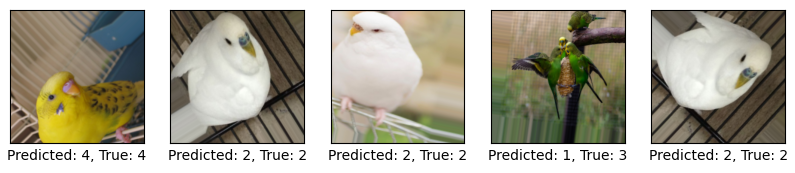

Confusion Matrix:
[[32  6  4  0  1]
 [10 26  2  5  1]
 [ 1  0 34  0  0]
 [ 0  4  0 29  1]
 [ 0  0  0  3 33]]
Accuracy: 0.8021
Precision: 0.7978
Recall: 0.8021
F1 Score: 0.7974
Time: 2.0 sec
Epoch 8/15:


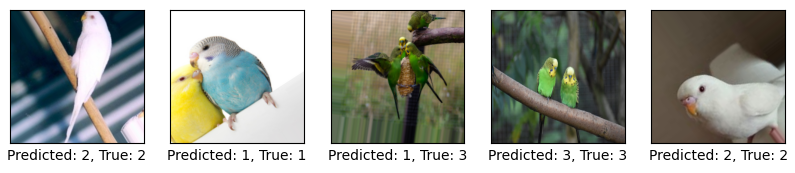

Confusion Matrix:
[[31  7  4  0  1]
 [ 7 31  2  3  1]
 [ 0  1 34  0  0]
 [ 0  4  0 29  1]
 [ 0  0  0  3 33]]
Accuracy: 0.8229
Precision: 0.8215
Recall: 0.8229
F1 Score: 0.8207
Time: 2.0 sec
Epoch 9/15:


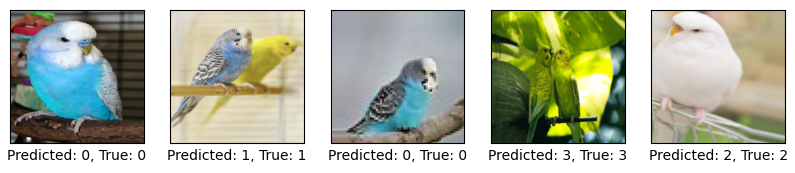

Confusion Matrix:
[[32  6  4  0  1]
 [ 7 31  2  3  1]
 [ 0  0 35  0  0]
 [ 0  4  0 29  1]
 [ 0  0  0  3 33]]
Accuracy: 0.8333
Precision: 0.8312
Recall: 0.8333
F1 Score: 0.8306
Time: 2.0 sec
Epoch 10/15:


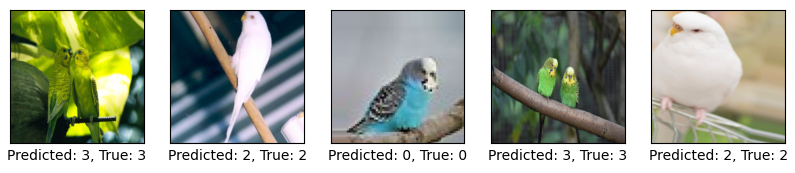

Confusion Matrix:
[[34  6  2  0  1]
 [ 8 28  2  5  1]
 [ 0  0 35  0  0]
 [ 0  2  0 32  0]
 [ 0  0  0  3 33]]
Accuracy: 0.8438
Precision: 0.8416
Recall: 0.8438
F1 Score: 0.8395
Time: 1.9 sec
Epoch 11/15:


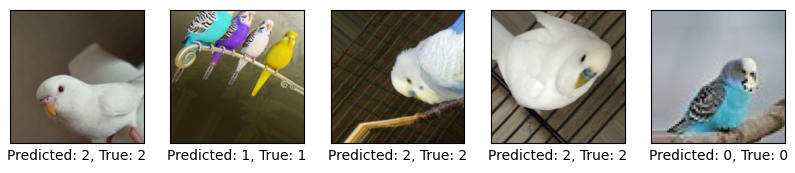

Confusion Matrix:
[[34  6  2  0  1]
 [ 8 29  2  4  1]
 [ 1  0 34  0  0]
 [ 0  4  0 30  0]
 [ 0  0  0  3 33]]
Accuracy: 0.8333
Precision: 0.8310
Recall: 0.8333
F1 Score: 0.8310
Time: 1.9 sec
Epoch 12/15:


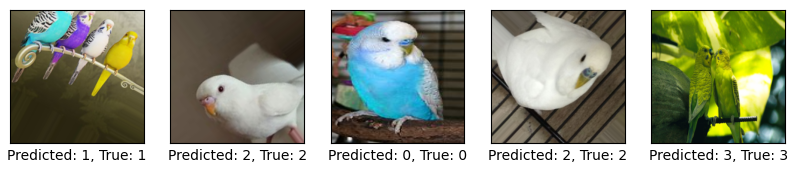

Confusion Matrix:
[[34  6  2  0  1]
 [ 7 30  2  4  1]
 [ 0  0 35  0  0]
 [ 0  4  0 30  0]
 [ 0  0  0  3 33]]
Accuracy: 0.8438
Precision: 0.8416
Recall: 0.8438
F1 Score: 0.8414
Time: 2.1 sec
Epoch 13/15:


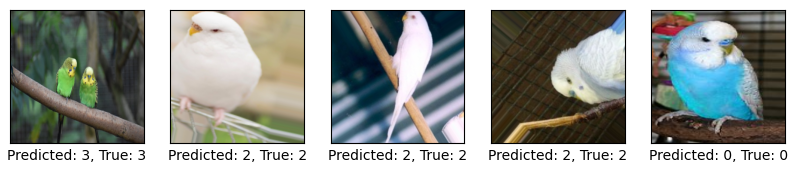

Confusion Matrix:
[[32  7  3  0  1]
 [ 7 29  2  5  1]
 [ 0  0 35  0  0]
 [ 0  4  0 29  1]
 [ 0  0  0  3 33]]
Accuracy: 0.8229
Precision: 0.8201
Recall: 0.8229
F1 Score: 0.8197
Time: 2.0 sec
Epoch 14/15:


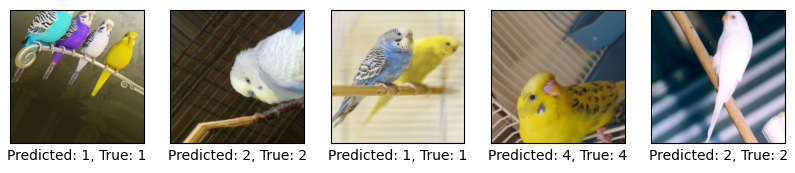

Confusion Matrix:
[[34  6  2  0  1]
 [ 6 33  2  2  1]
 [ 0  0 35  0  0]
 [ 0  4  0 30  0]
 [ 0  0  0  3 33]]
Accuracy: 0.8594
Precision: 0.8584
Recall: 0.8594
F1 Score: 0.8581
Time: 2.0 sec
Epoch 15/15:


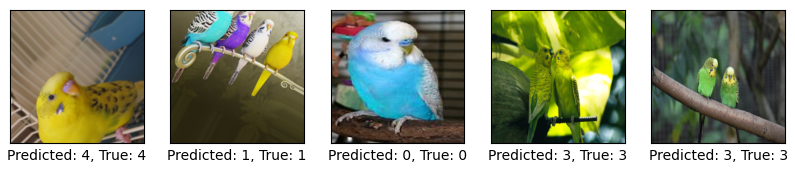

Confusion Matrix:
[[34  6  2  0  1]
 [ 6 33  2  2  1]
 [ 0  0 35  0  0]
 [ 0  4  0 30  0]
 [ 0  0  0  3 33]]
Accuracy: 0.8594
Precision: 0.8584
Recall: 0.8594
F1 Score: 0.8581
Time: 2.3 sec


In [ ]:
train_fine_tuning(finetune_net, 5e-5, batch_size=batch_size, num_epochs=15)

## Test run 2

Epoch 1/15:


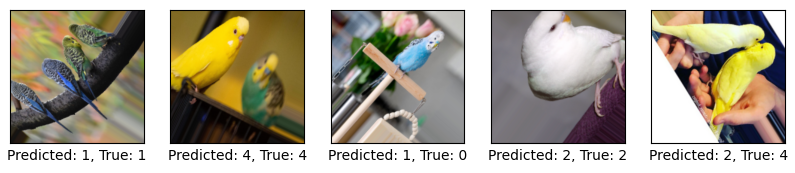

<ipython-input-15-255db1ea2a51>:5: UserWarning: Creating a tensor from a list of numpy.ndarrays is extremely slow. Please consider converting the list to a single numpy.ndarray with numpy.array() before converting to a tensor. (Triggered internally at ../torch/csrc/utils/tensor_new.cpp:275.)
  predicted_labels = torch.tensor(predicted_labels).argmax(dim=1).cpu().numpy()


Confusion Matrix:
[[20 14  9  5  1]
 [ 2 26  4 10  0]
 [ 2  5 30  0  0]
 [ 2 13  1 13  2]
 [ 2  7  3  6 26]]
Accuracy: 0.5665
Precision: 0.6242
Recall: 0.5665
F1 Score: 0.5716
Time: 3.0 sec
Epoch 2/15:


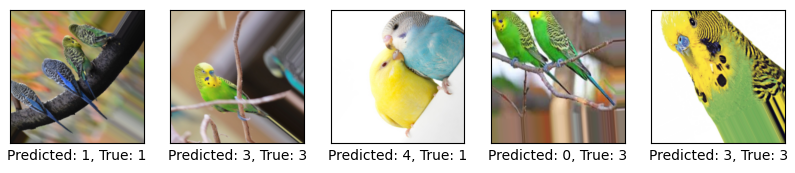

Confusion Matrix:
[[31 10  3  3  2]
 [ 1 28  1  7  5]
 [ 1  4 32  0  0]
 [ 4  5  0 15  7]
 [ 1  4  0  2 37]]
Accuracy: 0.7044
Precision: 0.7146
Recall: 0.7044
F1 Score: 0.7042
Time: 2.3 sec
Epoch 3/15:


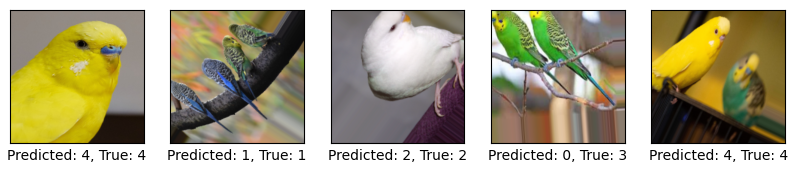

Confusion Matrix:
[[36  7  4  1  1]
 [ 3 24  2  6  7]
 [ 0  3 34  0  0]
 [ 4  4  0 15  8]
 [ 1  1  1  1 40]]
Accuracy: 0.7340
Precision: 0.7304
Recall: 0.7340
F1 Score: 0.7266
Time: 2.4 sec
Epoch 4/15:


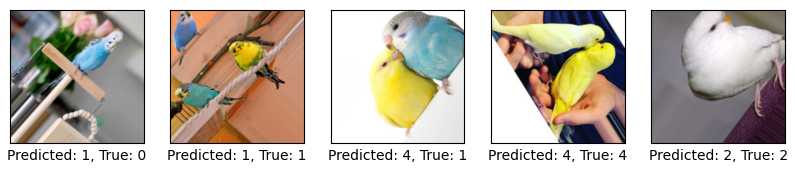

Confusion Matrix:
[[35  8  3  2  1]
 [ 1 30  2  5  4]
 [ 0  3 34  0  0]
 [ 4  5  0 16  6]
 [ 1  2  0  1 40]]
Accuracy: 0.7635
Precision: 0.7661
Recall: 0.7635
F1 Score: 0.7601
Time: 2.1 sec
Epoch 5/15:


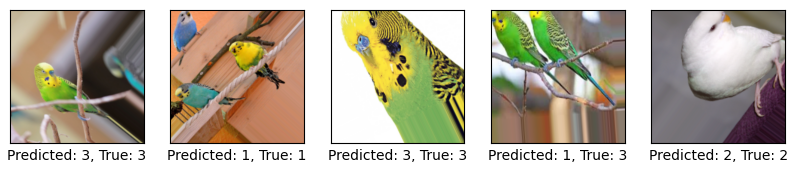

Confusion Matrix:
[[38  8  1  1  1]
 [ 1 31  1  5  4]
 [ 0  3 34  0  0]
 [ 3  4  0 21  3]
 [ 0  1  0  1 42]]
Accuracy: 0.8177
Precision: 0.8236
Recall: 0.8177
F1 Score: 0.8179
Time: 2.1 sec
Epoch 6/15:


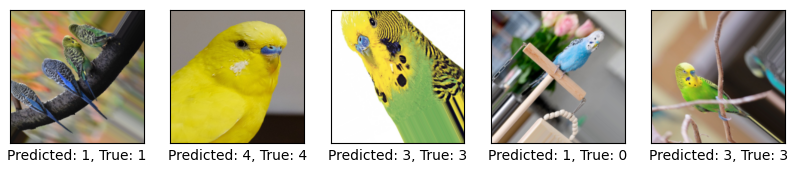

Confusion Matrix:
[[42  4  1  2  0]
 [ 1 30  1  8  2]
 [ 0  2 35  0  0]
 [ 4  2  0 24  1]
 [ 0  1  1  3 39]]
Accuracy: 0.8374
Precision: 0.8430
Recall: 0.8374
F1 Score: 0.8390
Time: 2.1 sec
Epoch 7/15:


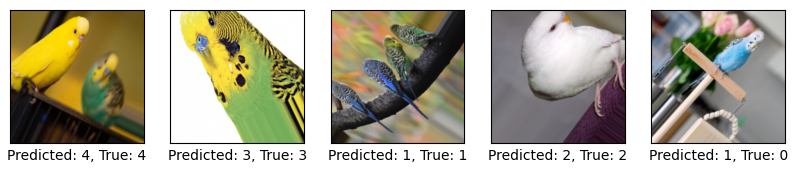

Confusion Matrix:
[[40  5  2  1  1]
 [ 1 30  1  8  2]
 [ 0  0 37  0  0]
 [ 4  2  0 24  1]
 [ 0  0  0  2 42]]
Accuracy: 0.8522
Precision: 0.8535
Recall: 0.8522
F1 Score: 0.8511
Time: 2.1 sec
Epoch 8/15:


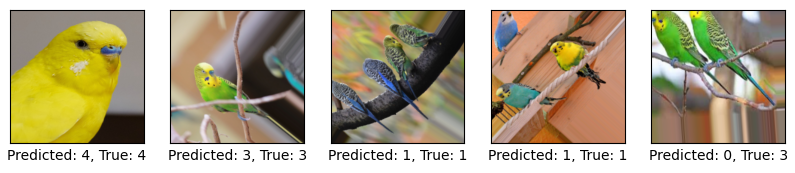

Confusion Matrix:
[[42  4  1  1  1]
 [ 1 33  0  6  2]
 [ 0  1 36  0  0]
 [ 4  3  0 23  1]
 [ 0  1  0  0 43]]
Accuracy: 0.8719
Precision: 0.8710
Recall: 0.8719
F1 Score: 0.8711
Time: 2.4 sec
Epoch 9/15:


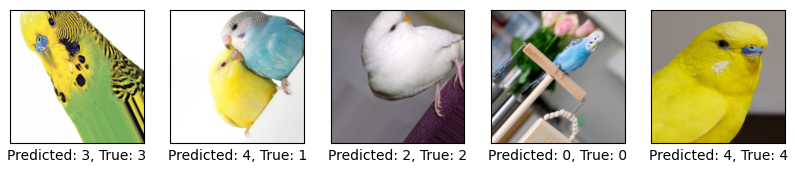

Confusion Matrix:
[[44  2  1  1  1]
 [ 4 26  0  8  4]
 [ 0  0 37  0  0]
 [ 4  1  0 25  1]
 [ 0  0  0  1 43]]
Accuracy: 0.8621
Precision: 0.8665
Recall: 0.8621
F1 Score: 0.8578
Time: 2.2 sec
Epoch 10/15:


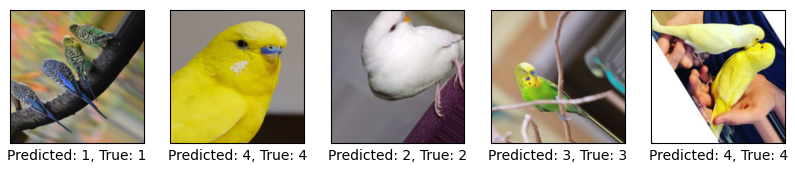

Confusion Matrix:
[[43  2  1  2  1]
 [ 3 29  0  8  2]
 [ 0  0 37  0  0]
 [ 3  1  0 26  1]
 [ 0  0  0  1 43]]
Accuracy: 0.8768
Precision: 0.8824
Recall: 0.8768
F1 Score: 0.8754
Time: 2.1 sec
Epoch 11/15:


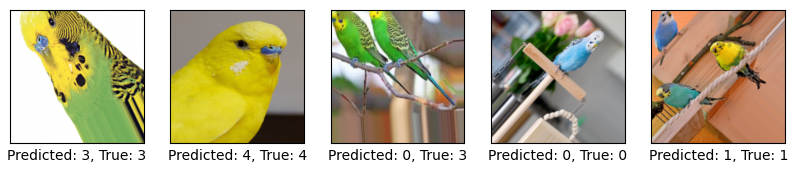

Confusion Matrix:
[[43  2  1  2  1]
 [ 2 30  0  7  3]
 [ 0  0 37  0  0]
 [ 3  1  0 26  1]
 [ 0  0  0  0 44]]
Accuracy: 0.8867
Precision: 0.8899
Recall: 0.8867
F1 Score: 0.8848
Time: 2.1 sec
Epoch 12/15:


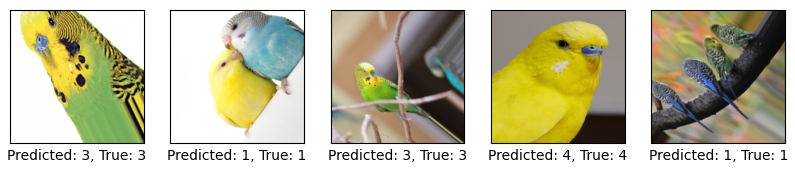

Confusion Matrix:
[[43  3  1  1  1]
 [ 1 33  0  6  2]
 [ 0  0 37  0  0]
 [ 3  2  0 25  1]
 [ 0  0  0  0 44]]
Accuracy: 0.8966
Precision: 0.8960
Recall: 0.8966
F1 Score: 0.8953
Time: 2.1 sec
Epoch 13/15:


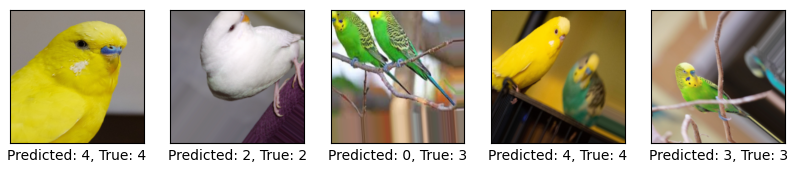

Confusion Matrix:
[[43  3  1  1  1]
 [ 1 33  0  6  2]
 [ 0  0 37  0  0]
 [ 4  2  0 24  1]
 [ 0  0  0  0 44]]
Accuracy: 0.8916
Precision: 0.8903
Recall: 0.8916
F1 Score: 0.8901
Time: 2.1 sec
Epoch 14/15:


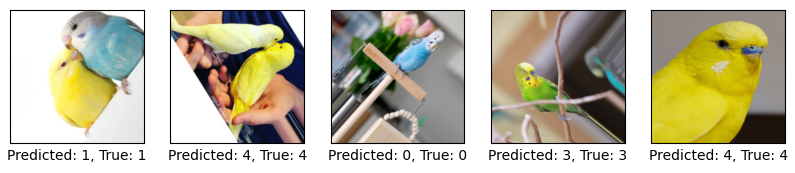

Confusion Matrix:
[[43  3  1  1  1]
 [ 1 34  0  6  1]
 [ 0  0 37  0  0]
 [ 2  2  0 26  1]
 [ 0  1  0  0 43]]
Accuracy: 0.9015
Precision: 0.9019
Recall: 0.9015
F1 Score: 0.9011
Time: 2.3 sec
Epoch 15/15:


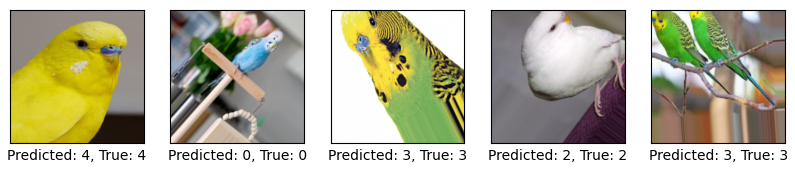

Confusion Matrix:
[[43  2  1  2  1]
 [ 3 31  0  6  2]
 [ 0  0 37  0  0]
 [ 2  1  0 27  1]
 [ 0  0  0  0 44]]
Accuracy: 0.8966
Precision: 0.8988
Recall: 0.8966
F1 Score: 0.8949
Time: 2.7 sec


In [ ]:
train_fine_tuning(finetune_net, 5e-5, batch_size=batch_size, num_epochs=15)

## Test Run 3

Epoch 1/15:


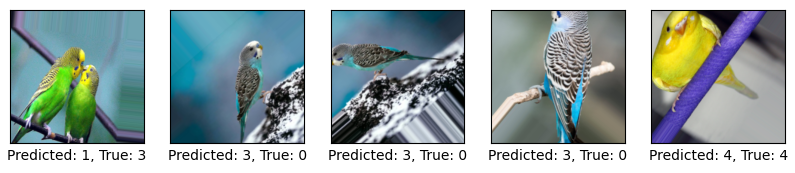

<ipython-input-15-255db1ea2a51>:5: UserWarning: Creating a tensor from a list of numpy.ndarrays is extremely slow. Please consider converting the list to a single numpy.ndarray with numpy.array() before converting to a tensor. (Triggered internally at ../torch/csrc/utils/tensor_new.cpp:275.)
  predicted_labels = torch.tensor(predicted_labels).argmax(dim=1).cpu().numpy()


Confusion Matrix:
[[16 14  7 15  0]
 [ 1 21  3 11  3]
 [ 0  5 37  0  0]
 [ 5 10  0 14  2]
 [ 1  4  2  1 35]]
Accuracy: 0.5942
Precision: 0.6341
Recall: 0.5942
F1 Score: 0.5907
Time: 3.5 sec
Epoch 2/15:


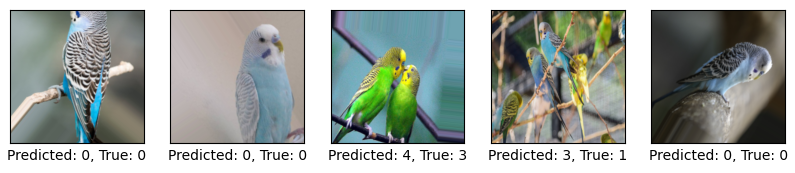

Confusion Matrix:
[[45  0  1  5  1]
 [10 13  1 13  2]
 [ 0  1 39  2  0]
 [ 6  2  0 20  3]
 [ 1  0  0  2 40]]
Accuracy: 0.7585
Precision: 0.7804
Recall: 0.7585
F1 Score: 0.7468
Time: 2.1 sec
Epoch 3/15:


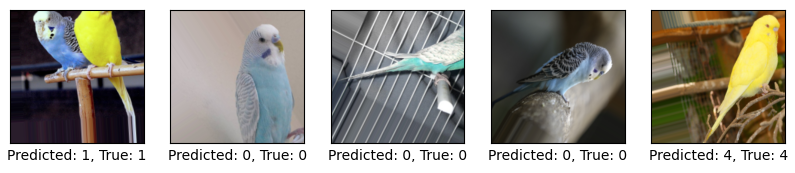

Confusion Matrix:
[[35  6  4  7  0]
 [ 4 23  0 12  0]
 [ 0  1 41  0  0]
 [ 3  2  0 23  3]
 [ 0  0  0  3 40]]
Accuracy: 0.7826
Precision: 0.7994
Recall: 0.7826
F1 Score: 0.7843
Time: 2.3 sec
Epoch 4/15:


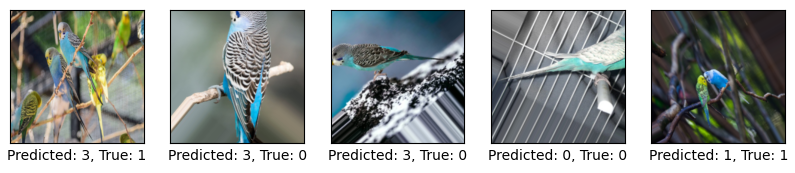

Confusion Matrix:
[[42  3  0  7  0]
 [ 2 23  0 13  1]
 [ 0  1 41  0  0]
 [ 1  1  0 26  3]
 [ 0  0  0  2 41]]
Accuracy: 0.8357
Precision: 0.8625
Recall: 0.8357
F1 Score: 0.8395
Time: 2.1 sec
Epoch 5/15:


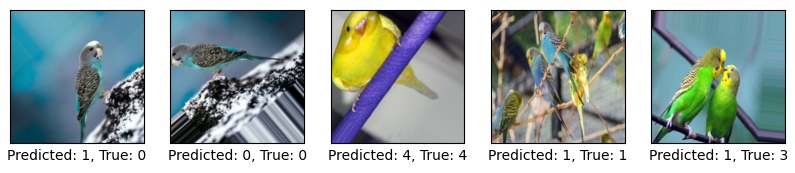

Confusion Matrix:
[[29 18  3  2  0]
 [ 2 33  0  4  0]
 [ 0  1 41  0  0]
 [ 1  4  0 25  1]
 [ 0  0  0  2 41]]
Accuracy: 0.8164
Precision: 0.8440
Recall: 0.8164
F1 Score: 0.8152
Time: 2.1 sec
Epoch 6/15:


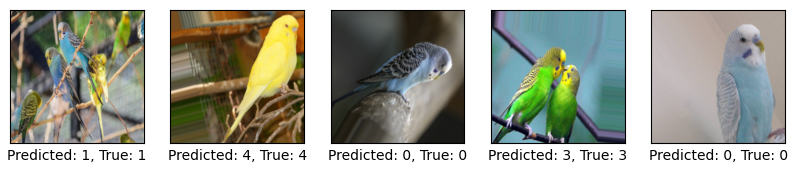

Confusion Matrix:
[[41  6  2  3  0]
 [ 2 28  0  9  0]
 [ 0  0 42  0  0]
 [ 0  1  0 28  2]
 [ 0  0  0  2 41]]
Accuracy: 0.8696
Precision: 0.8818
Recall: 0.8696
F1 Score: 0.8705
Time: 2.2 sec
Epoch 7/15:


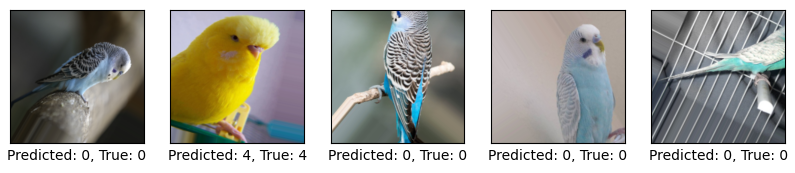

Confusion Matrix:
[[50  1  0  1  0]
 [ 4 28  0  7  0]
 [ 0  0 42  0  0]
 [ 1  2  0 26  2]
 [ 0  0  0  2 41]]
Accuracy: 0.9034
Precision: 0.9077
Recall: 0.9034
F1 Score: 0.9027
Time: 2.4 sec
Epoch 8/15:


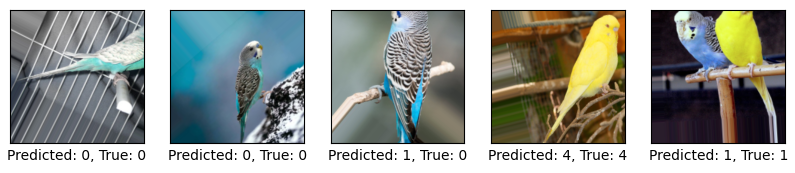

Confusion Matrix:
[[41  7  1  3  0]
 [ 2 29  0  8  0]
 [ 0  0 42  0  0]
 [ 0  1  0 29  1]
 [ 0  0  0  2 41]]
Accuracy: 0.8792
Precision: 0.8916
Recall: 0.8792
F1 Score: 0.8805
Time: 2.2 sec
Epoch 9/15:


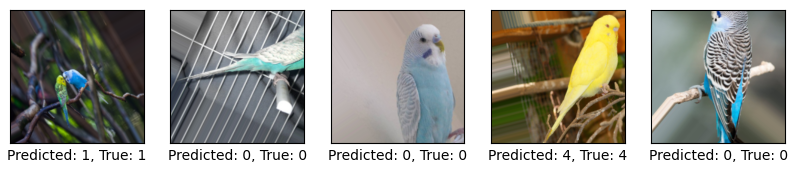

Confusion Matrix:
[[48  3  0  1  0]
 [ 3 31  0  5  0]
 [ 0  0 42  0  0]
 [ 0  3  0 28  0]
 [ 0  0  0  2 41]]
Accuracy: 0.9179
Precision: 0.9214
Recall: 0.9179
F1 Score: 0.9187
Time: 2.1 sec
Epoch 10/15:


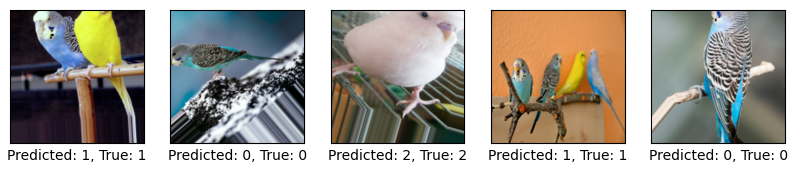

Confusion Matrix:
[[48  2  0  2  0]
 [ 3 30  0  6  0]
 [ 0  0 42  0  0]
 [ 0  0  0 29  2]
 [ 0  0  0  2 41]]
Accuracy: 0.9179
Precision: 0.9254
Recall: 0.9179
F1 Score: 0.9184
Time: 2.1 sec
Epoch 11/15:


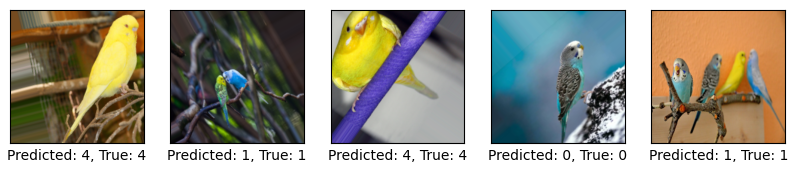

Confusion Matrix:
[[44  5  0  3  0]
 [ 2 30  0  7  0]
 [ 0  0 42  0  0]
 [ 0  1  0 28  2]
 [ 0  0  0  2 41]]
Accuracy: 0.8937
Precision: 0.9031
Recall: 0.8937
F1 Score: 0.8954
Time: 2.1 sec
Epoch 12/15:


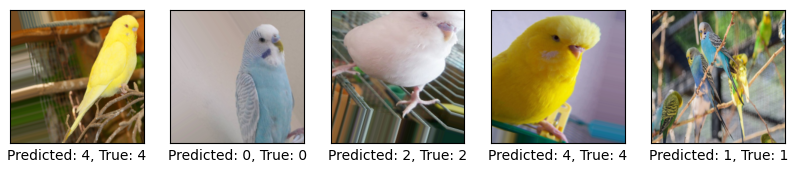

Confusion Matrix:
[[45  5  0  2  0]
 [ 2 34  0  3  0]
 [ 0  0 42  0  0]
 [ 0  1  0 28  2]
 [ 0  0  0  2 41]]
Accuracy: 0.9179
Precision: 0.9214
Recall: 0.9179
F1 Score: 0.9186
Time: 2.1 sec
Epoch 13/15:


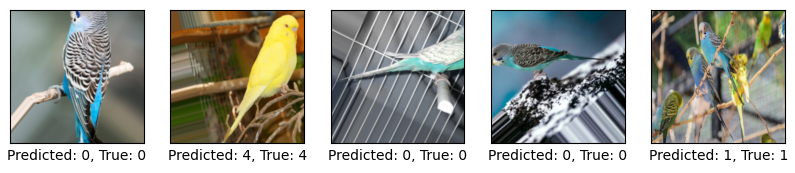

Confusion Matrix:
[[46  4  0  2  0]
 [ 3 34  0  2  0]
 [ 0  0 42  0  0]
 [ 0  1  0 29  1]
 [ 0  0  0  2 41]]
Accuracy: 0.9275
Precision: 0.9298
Recall: 0.9275
F1 Score: 0.9280
Time: 2.3 sec
Epoch 14/15:


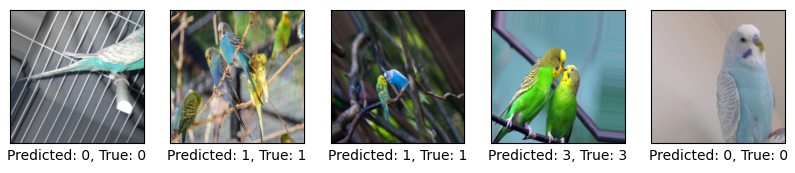

Confusion Matrix:
[[50  1  0  1  0]
 [ 3 33  0  3  0]
 [ 0  0 42  0  0]
 [ 0  0  0 30  1]
 [ 0  0  0  2 41]]
Accuracy: 0.9469
Precision: 0.9503
Recall: 0.9469
F1 Score: 0.9470
Time: 2.3 sec
Epoch 15/15:


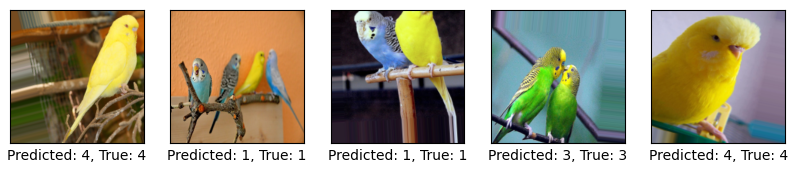

Confusion Matrix:
[[48  2  0  2  0]
 [ 3 34  0  2  0]
 [ 0  0 42  0  0]
 [ 0  1  0 28  2]
 [ 0  0  0  2 41]]
Accuracy: 0.9324
Precision: 0.9339
Recall: 0.9324
F1 Score: 0.9327
Time: 2.3 sec


In [ ]:
train_fine_tuning(finetune_net, 5e-5, batch_size=batch_size, num_epochs=15)

## Run 4

Epoch 1/15:


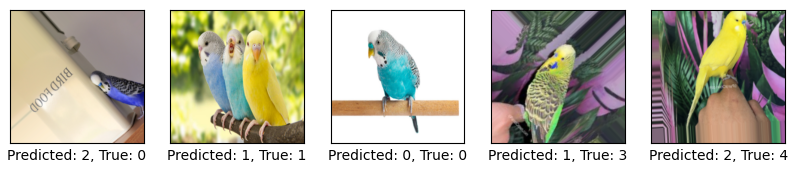

Confusion Matrix:
[[17 16 19  0  0]
 [ 4 27  4  3  1]
 [ 3  2 36  1  0]
 [ 4 14  3  9  1]
 [ 0  4 14  1 24]]
Accuracy: 0.5459
Precision: 0.6174
Recall: 0.5459
F1 Score: 0.5347
Loss: 1.492
Time: 2.2 sec
Epoch 2/15:


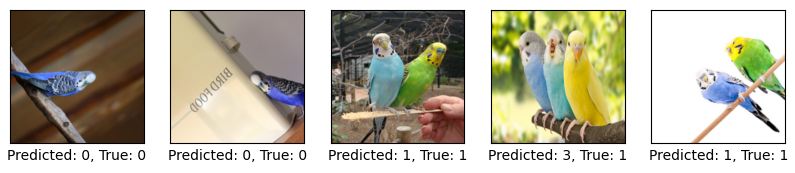

Confusion Matrix:
[[30 16  3  1  2]
 [ 6 24  0  8  1]
 [ 2  3 36  0  1]
 [ 3  7  1 13  7]
 [ 0  3  0  1 39]]
Accuracy: 0.6860
Precision: 0.6984
Recall: 0.6860
F1 Score: 0.6849
Loss: 0.869
Time: 2.2 sec
Epoch 3/15:


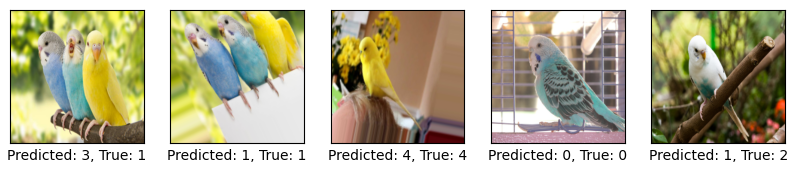

Confusion Matrix:
[[36 10  3  1  2]
 [ 6 22  0 10  1]
 [ 2  2 37  0  1]
 [ 2  4  0 22  3]
 [ 0  1  0  1 41]]
Accuracy: 0.7633
Precision: 0.7649
Recall: 0.7633
F1 Score: 0.7625
Loss: 0.579
Time: 2.2 sec
Epoch 4/15:


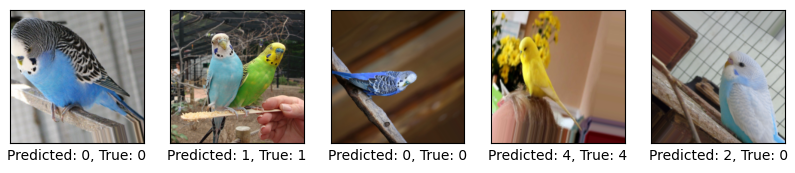

Confusion Matrix:
[[41  7  2  2  0]
 [ 8 19  0 11  1]
 [ 2  1 38  1  0]
 [ 1  2  0 28  0]
 [ 0  1  0  2 40]]
Accuracy: 0.8019
Precision: 0.8081
Recall: 0.8019
F1 Score: 0.7995
Loss: 0.451
Time: 2.4 sec
Epoch 5/15:


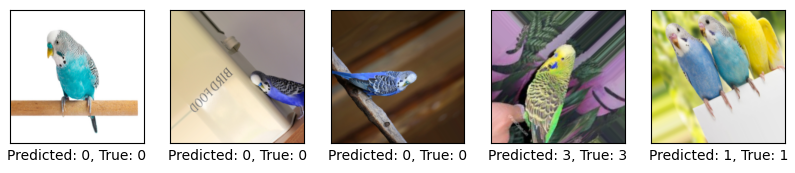

Confusion Matrix:
[[39 10  2  1  0]
 [ 5 26  0  7  1]
 [ 3  1 38  0  0]
 [ 2  4  0 25  0]
 [ 0  4  0  2 37]]
Accuracy: 0.7971
Precision: 0.8108
Recall: 0.7971
F1 Score: 0.8019
Loss: 0.385
Time: 2.5 sec
Epoch 6/15:


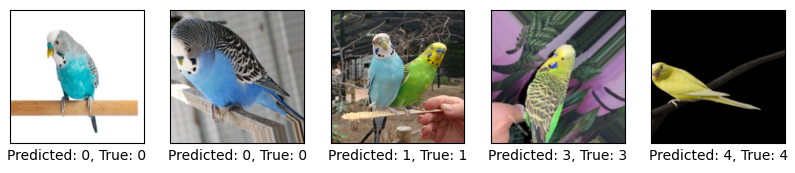

Confusion Matrix:
[[40  8  3  1  0]
 [ 6 27  0  5  1]
 [ 3  0 39  0  0]
 [ 1  4  0 26  0]
 [ 0  2  0  2 39]]
Accuracy: 0.8261
Precision: 0.8305
Recall: 0.8261
F1 Score: 0.8276
Loss: 0.280
Time: 2.2 sec
Epoch 7/15:


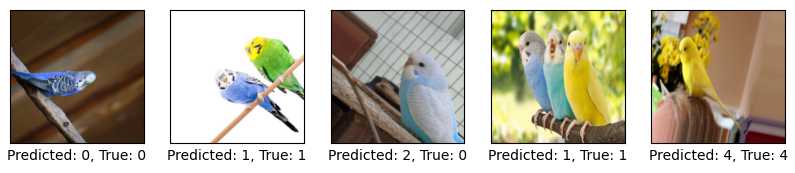

Confusion Matrix:
[[40  8  3  1  0]
 [ 5 29  0  4  1]
 [ 1  1 40  0  0]
 [ 0  7  0 24  0]
 [ 0  1  0  1 41]]
Accuracy: 0.8406
Precision: 0.8486
Recall: 0.8406
F1 Score: 0.8428
Loss: 0.243
Time: 2.2 sec
Epoch 8/15:


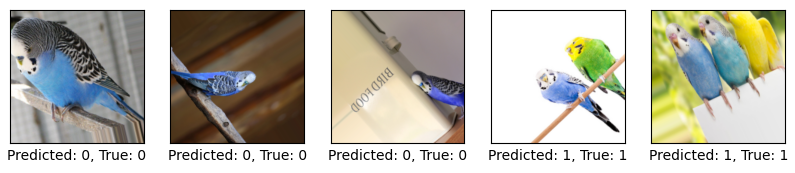

Confusion Matrix:
[[43  6  2  1  0]
 [ 5 25  0  8  1]
 [ 1  1 40  0  0]
 [ 0  2  0 29  0]
 [ 0  0  0  2 41]]
Accuracy: 0.8599
Precision: 0.8636
Recall: 0.8599
F1 Score: 0.8589
Loss: 0.211
Time: 2.4 sec
Epoch 9/15:


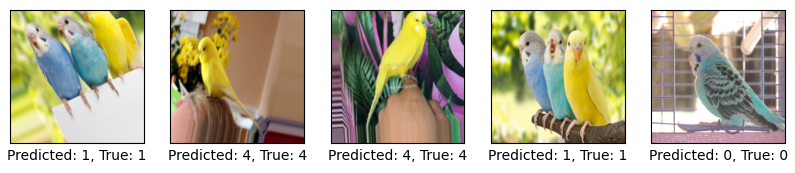

Confusion Matrix:
[[44  5  2  1  0]
 [ 5 23  0 10  1]
 [ 0  0 42  0  0]
 [ 0  0  0 31  0]
 [ 0  0  0  2 41]]
Accuracy: 0.8744
Precision: 0.8823
Recall: 0.8744
F1 Score: 0.8706
Loss: 0.172
Time: 2.2 sec
Epoch 10/15:


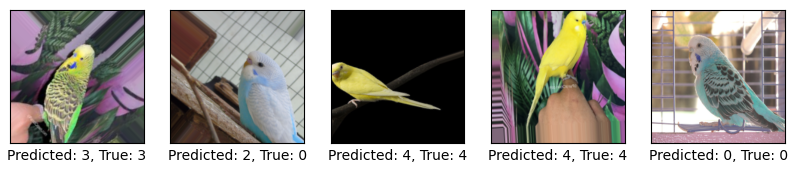

Confusion Matrix:
[[44  5  2  1  0]
 [ 5 27  0  6  1]
 [ 2  0 40  0  0]
 [ 0  3  0 28  0]
 [ 0  0  0  1 42]]
Accuracy: 0.8744
Precision: 0.8747
Recall: 0.8744
F1 Score: 0.8734
Loss: 0.150
Time: 2.3 sec
Epoch 11/15:


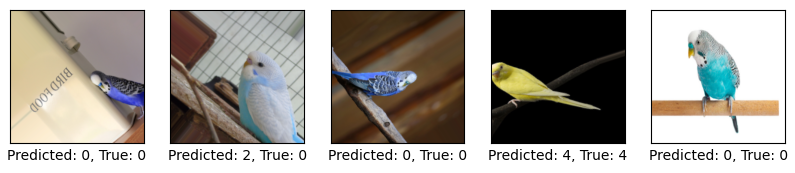

Confusion Matrix:
[[44  5  2  1  0]
 [ 5 28  0  5  1]
 [ 2  0 40  0  0]
 [ 0  4  0 27  0]
 [ 0  1  0  1 41]]
Accuracy: 0.8696
Precision: 0.8705
Recall: 0.8696
F1 Score: 0.8697
Loss: 0.132
Time: 2.4 sec
Epoch 12/15:


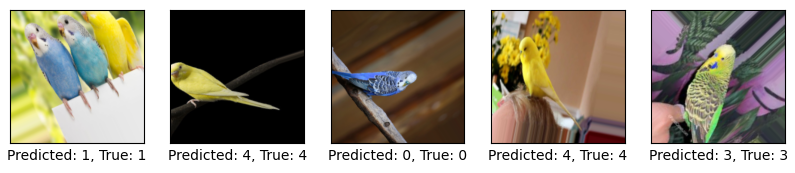

Confusion Matrix:
[[43  6  2  1  0]
 [ 5 25  0  8  1]
 [ 0  0 42  0  0]
 [ 0  0  0 31  0]
 [ 0  0  0  1 42]]
Accuracy: 0.8841
Precision: 0.8868
Recall: 0.8841
F1 Score: 0.8807
Loss: 0.126
Time: 2.2 sec
Epoch 13/15:


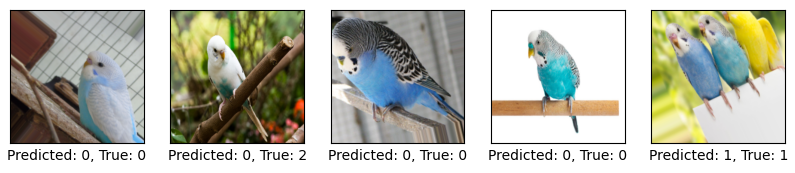

Confusion Matrix:
[[42  8  1  1  0]
 [ 5 29  0  4  1]
 [ 1  0 41  0  0]
 [ 0  4  0 27  0]
 [ 0  1  0  1 41]]
Accuracy: 0.8696
Precision: 0.8733
Recall: 0.8696
F1 Score: 0.8707
Loss: 0.108
Time: 2.2 sec
Epoch 14/15:


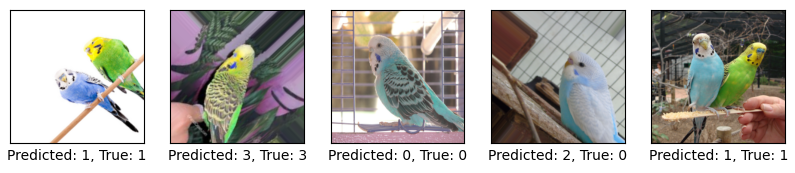

Confusion Matrix:
[[46  3  2  1  0]
 [ 5 25  0  8  1]
 [ 0  0 42  0  0]
 [ 0  0  0 31  0]
 [ 0  0  0  2 41]]
Accuracy: 0.8937
Precision: 0.9018
Recall: 0.8937
F1 Score: 0.8908
Loss: 0.098
Time: 2.2 sec
Epoch 15/15:


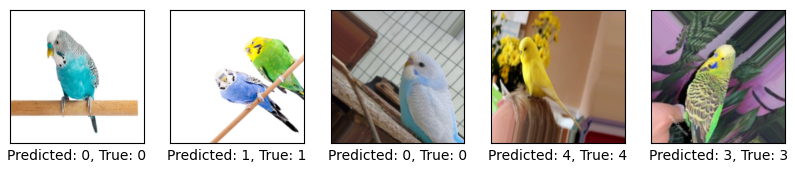

Confusion Matrix:
[[48  2  1  1  0]
 [ 5 28  0  5  1]
 [ 0  0 42  0  0]
 [ 0  1  0 30  0]
 [ 0  0  0  1 42]]
Accuracy: 0.9179
Precision: 0.9202
Recall: 0.9179
F1 Score: 0.9160
Loss: 0.086
Time: 2.2 sec


In [ ]:
train_fine_tuning(finetune_net, 5e-5, batch_size=batch_size, num_epochs=15)

## Run 5: Using RMSProp optimizer, learning rate 5e-5

In [ ]:
train_fine_tuning(finetune_net, 5e-5, batch_size=batch_size, num_epochs=15)

Epoch 1/15:


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Confusion Matrix:
[[ 0 24  0 17 11]
 [ 0  2  0 24 16]
 [ 0 15  5  2 20]
 [ 0  2  0 31  2]
 [ 0  0  0 28 10]]
Accuracy: 0.2297
Precision: 0.2920
Recall: 0.2297
F1 Score: 0.1655
Loss: 1.605
Time: 2.0 sec
Epoch 2/15:
Confusion Matrix:
[[45  3  2  2  0]
 [ 4 29  0  6  3]
 [ 0  0 39  2  1]
 [ 0  3  2 24  6]
 [ 0  0  0  2 36]]
Accuracy: 0.8278
Precision: 0.8312
Recall: 0.8278
F1 Score: 0.8265
Loss: 0.796
Time: 1.9 sec
Epoch 3/15:
Confusion Matrix:
[[24  7 19  0  2]
 [ 1 26  3  9  3]
 [ 0  0 40  0  2]
 [ 0  1  0 33  1]
 [ 0  0  0  1 37]]
Accuracy: 0.7656
Precision: 0.8002
Recall: 0.7656
F1 Score: 0.7510
Loss: 0.478
Time: 1.9 sec
Epoch 4/15:
Confusion Matrix:
[[49  0  3  0  0]
 [ 7 29  0  6  0]
 [ 1  0 41  0  0]
 [ 0  2  0 33  0]
 [ 0  0  1  2 35]]
Accuracy: 0.8947
Precision: 0.9016
Recall: 0.8947
F1 Score: 0.8925
Loss: 0.321
Time: 1.9 sec
Epoch 5/15:
Confusion Matrix:
[[40  8  2  2  0]
 [ 3 32  0  2  5]
 [ 2  0 39  0  1]
 [ 0  4  0 22  9]
 [ 0  0  0  0 38]]
Accuracy: 0.8182
Precision: 0.8305


## Run 6: Adam, learning rate 5e-5

Epoch 1/15:


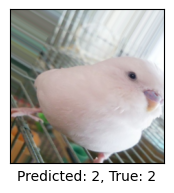

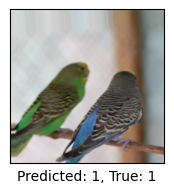

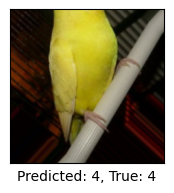

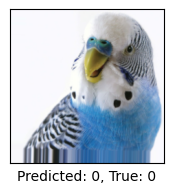

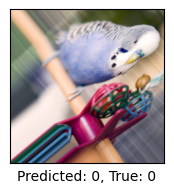

...

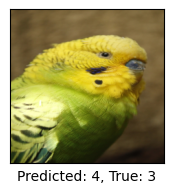

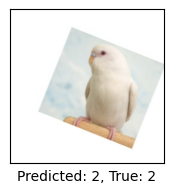

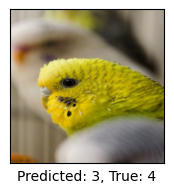

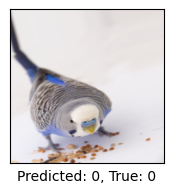

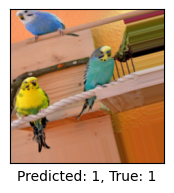

Confusion Matrix:
[[40  3  7  2  0]
 [ 0 35  1  5  1]
 [ 0  1 41  0  0]
 [ 0  1  0 32  2]
 [ 0  0  1  1 36]]
Accuracy: 0.8804
Precision: 0.8912
Recall: 0.8804
F1 Score: 0.8799
Loss: 1.093
Time: 3.3 sec
Epoch 2/15:


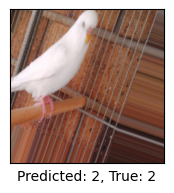

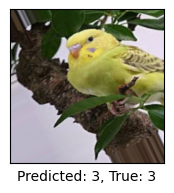

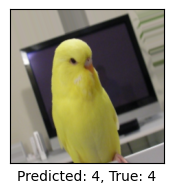

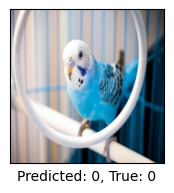

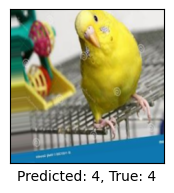

...

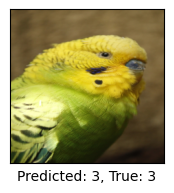

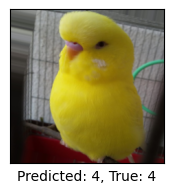

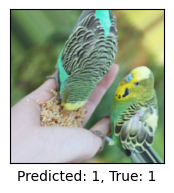

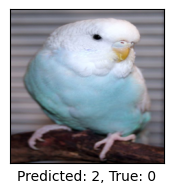

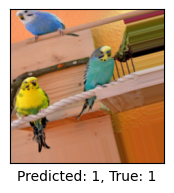

Confusion Matrix:
[[47  1  4  0  0]
 [ 2 36  0  4  0]
 [ 0  0 42  0  0]
 [ 0  0  0 34  1]
 [ 0  0  1  1 36]]
Accuracy: 0.9330
Precision: 0.9367
Recall: 0.9330
F1 Score: 0.9328
Loss: 0.121
Time: 3.2 sec
Epoch 3/15:


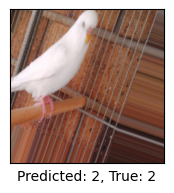

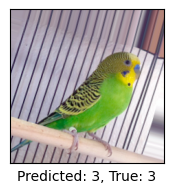

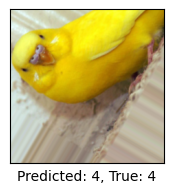

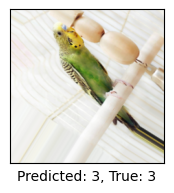

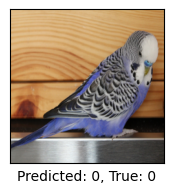

...

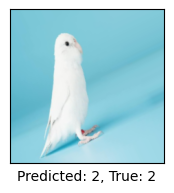

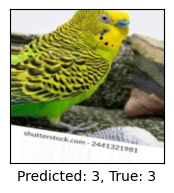

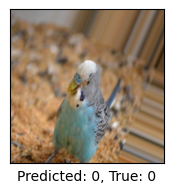

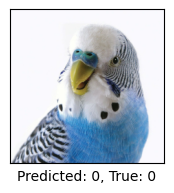

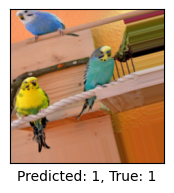

Confusion Matrix:
[[46  1  5  0  0]
 [ 0 38  0  3  1]
 [ 0  0 42  0  0]
 [ 0  0  0 34  1]
 [ 0  0  1  1 36]]
Accuracy: 0.9378
Precision: 0.9425
Recall: 0.9378
F1 Score: 0.9379
Loss: 0.044
Time: 3.7 sec
Epoch 4/15:


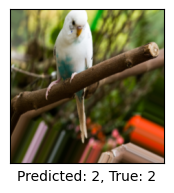

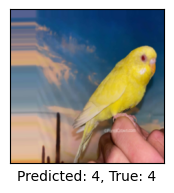

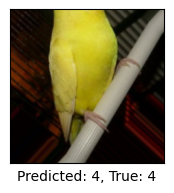

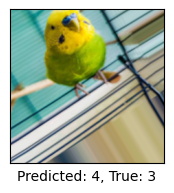

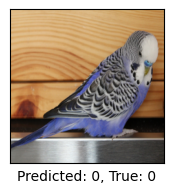

...

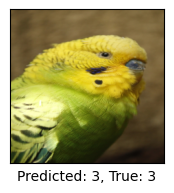

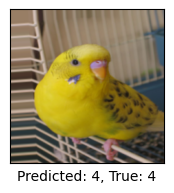

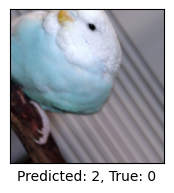

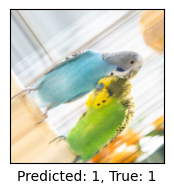

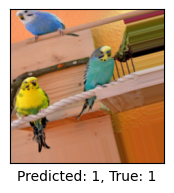

Confusion Matrix:
[[47  0  5  0  0]
 [ 1 36  0  5  0]
 [ 0  0 42  0  0]
 [ 0  0  0 34  1]
 [ 0  0  0  1 37]]
Accuracy: 0.9378
Precision: 0.9435
Recall: 0.9378
F1 Score: 0.9379
Loss: 0.036
Time: 3.5 sec
Epoch 5/15:


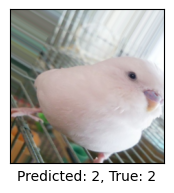

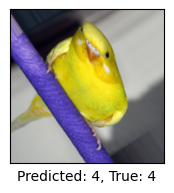

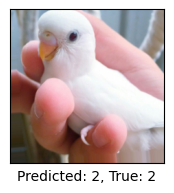

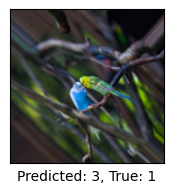

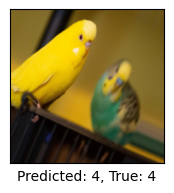

...

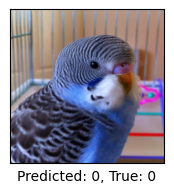

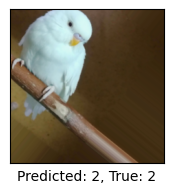

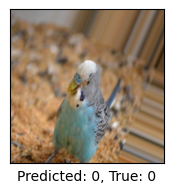

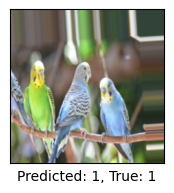

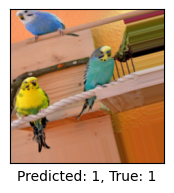

Confusion Matrix:
[[48  0  4  0  0]
 [ 1 37  0  4  0]
 [ 0  0 42  0  0]
 [ 0  0  0 34  1]
 [ 0  0  0  1 37]]
Accuracy: 0.9474
Precision: 0.9512
Recall: 0.9474
F1 Score: 0.9475
Loss: 0.021
Time: 3.5 sec
Epoch 6/15:


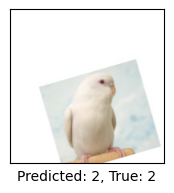

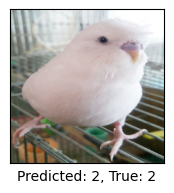

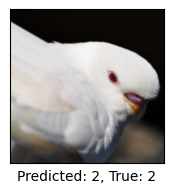

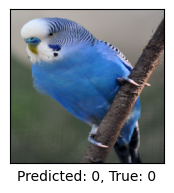

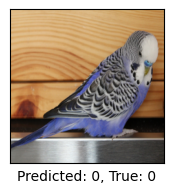

...

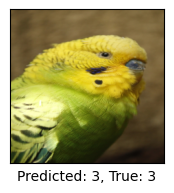

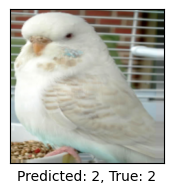

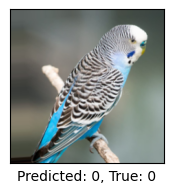

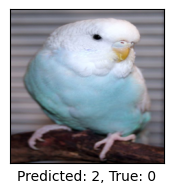

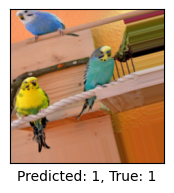

Confusion Matrix:
[[47  1  4  0  0]
 [ 1 38  0  3  0]
 [ 0  0 42  0  0]
 [ 0  0  0 34  1]
 [ 0  0  0  1 37]]
Accuracy: 0.9474
Precision: 0.9498
Recall: 0.9474
F1 Score: 0.9473
Loss: 0.018
Time: 3.4 sec
Epoch 7/15:


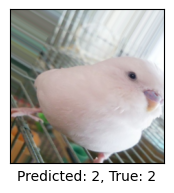

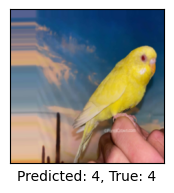

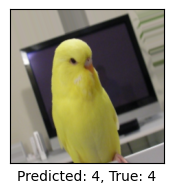

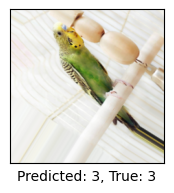

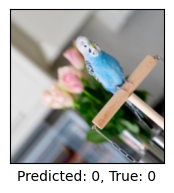

...

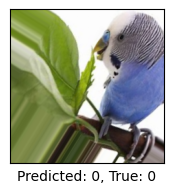

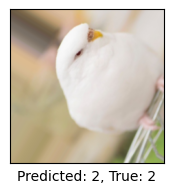

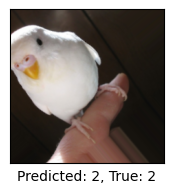

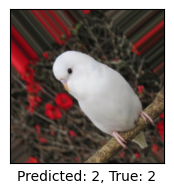

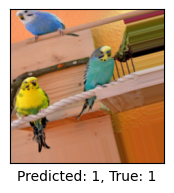

Confusion Matrix:
[[47  1  4  0  0]
 [ 1 38  0  3  0]
 [ 0  0 42  0  0]
 [ 0  0  0 34  1]
 [ 0  0  1  1 36]]
Accuracy: 0.9426
Precision: 0.9457
Recall: 0.9426
F1 Score: 0.9426
Loss: 0.015
Time: 4.4 sec
Epoch 8/15:


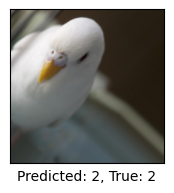

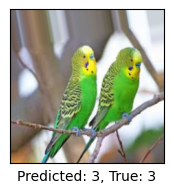

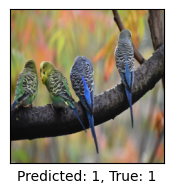

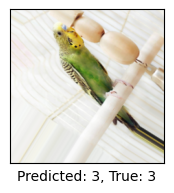

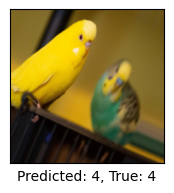

...

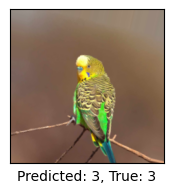

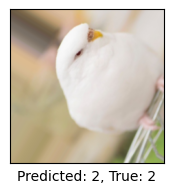

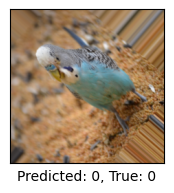

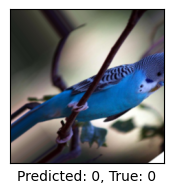

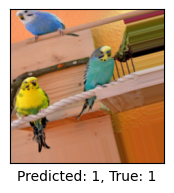

Confusion Matrix:
[[46  1  5  0  0]
 [ 1 38  0  3  0]
 [ 0  0 42  0  0]
 [ 0  0  0 32  3]
 [ 0  0  1  0 37]]
Accuracy: 0.9330
Precision: 0.9364
Recall: 0.9330
F1 Score: 0.9329
Loss: 0.017
Time: 3.6 sec
Epoch 9/15:


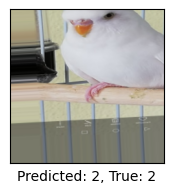

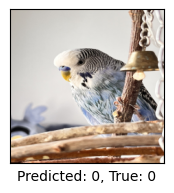

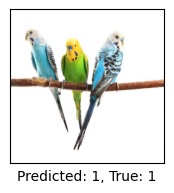

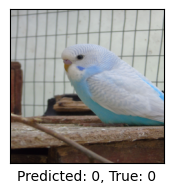

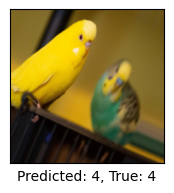

...

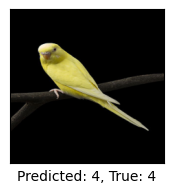

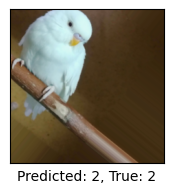

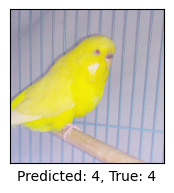

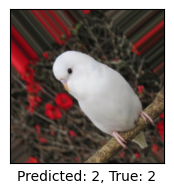

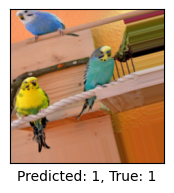

Confusion Matrix:
[[45  1  5  1  0]
 [ 0 38  0  4  0]
 [ 0  0 42  0  0]
 [ 0  0  0 33  2]
 [ 0  0  0  1 37]]
Accuracy: 0.9330
Precision: 0.9384
Recall: 0.9330
F1 Score: 0.9332
Loss: 0.009
Time: 3.6 sec
Epoch 10/15:


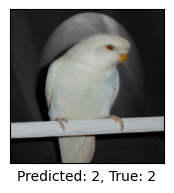

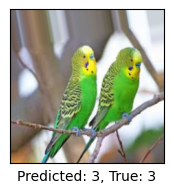

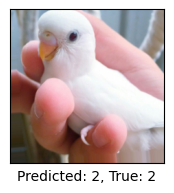

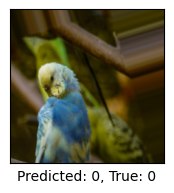

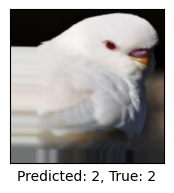

...

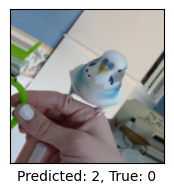

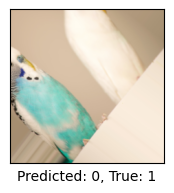

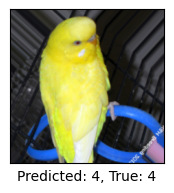

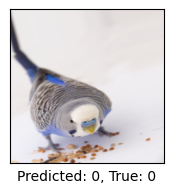

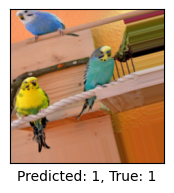

Confusion Matrix:
[[49  0  3  0  0]
 [ 1 38  0  3  0]
 [ 0  0 42  0  0]
 [ 0  0  0 34  1]
 [ 0  0  1  1 36]]
Accuracy: 0.9522
Precision: 0.9550
Recall: 0.9522
F1 Score: 0.9523
Loss: 0.011
Time: 3.8 sec
Epoch 11/15:


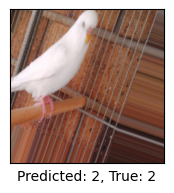

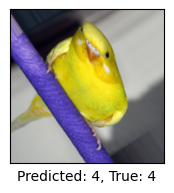

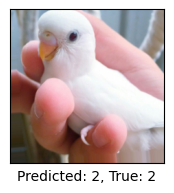

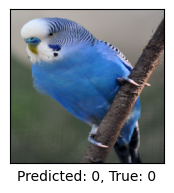

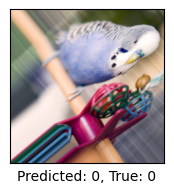

...

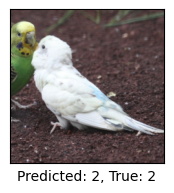

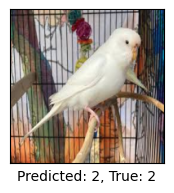

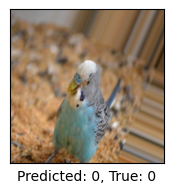

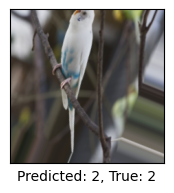

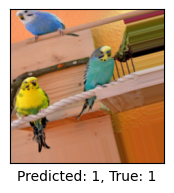

Confusion Matrix:
[[47  0  5  0  0]
 [ 1 38  0  3  0]
 [ 0  0 42  0  0]
 [ 0  0  0 34  1]
 [ 0  0  1  1 36]]
Accuracy: 0.9426
Precision: 0.9472
Recall: 0.9426
F1 Score: 0.9429
Loss: 0.006
Time: 4.1 sec
Epoch 12/15:


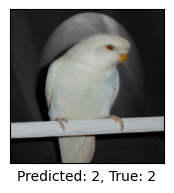

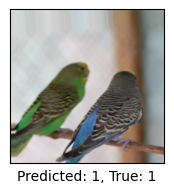

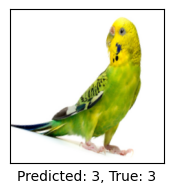

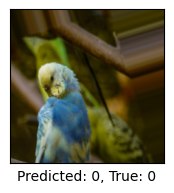

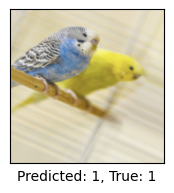

...

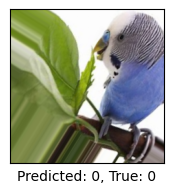

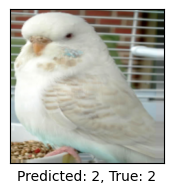

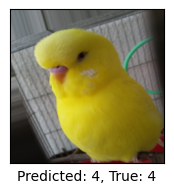

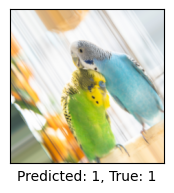

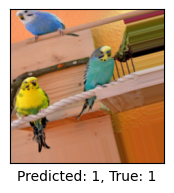

Confusion Matrix:
[[48  0  4  0  0]
 [ 1 38  0  3  0]
 [ 0  0 42  0  0]
 [ 0  0  0 34  1]
 [ 0  0  0  1 37]]
Accuracy: 0.9522
Precision: 0.9550
Recall: 0.9522
F1 Score: 0.9522
Loss: 0.006
Time: 3.8 sec
Epoch 13/15:


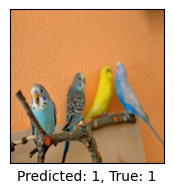

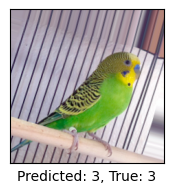

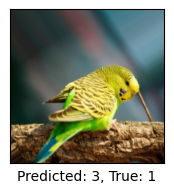

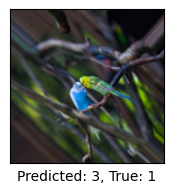

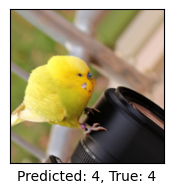

...

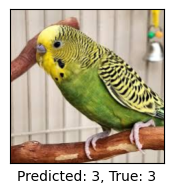

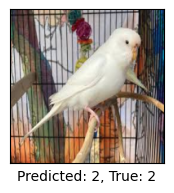

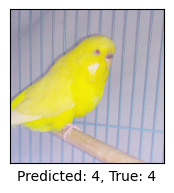

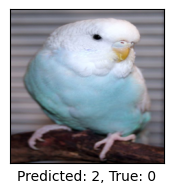

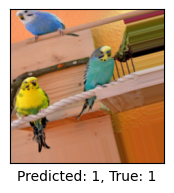

Confusion Matrix:
[[47  0  5  0  0]
 [ 1 38  0  3  0]
 [ 0  0 42  0  0]
 [ 0  0  0 34  1]
 [ 0  0  0  1 37]]
Accuracy: 0.9474
Precision: 0.9510
Recall: 0.9474
F1 Score: 0.9475
Loss: 0.005
Time: 4.3 sec
Epoch 14/15:


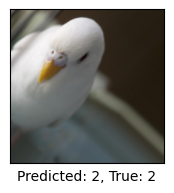

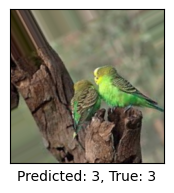

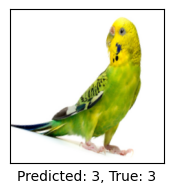

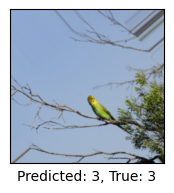

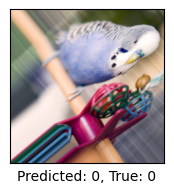

...

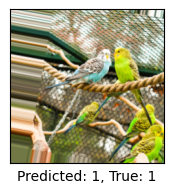

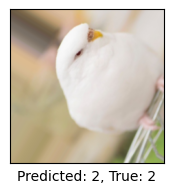

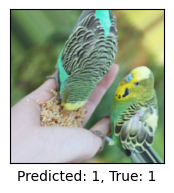

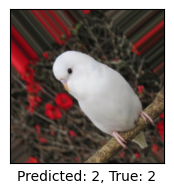

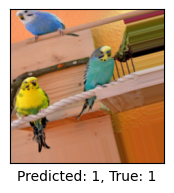

Confusion Matrix:
[[47  0  5  0  0]
 [ 1 39  0  2  0]
 [ 0  0 42  0  0]
 [ 0  0  0 34  1]
 [ 0  0  0  1 37]]
Accuracy: 0.9522
Precision: 0.9551
Recall: 0.9522
F1 Score: 0.9523
Loss: 0.004
Time: 4.0 sec
Epoch 15/15:


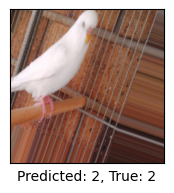

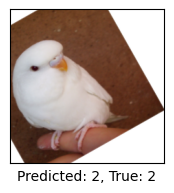

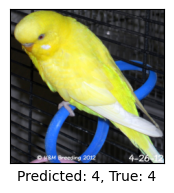

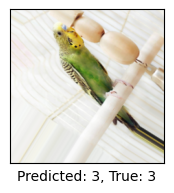

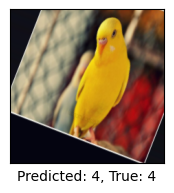

...

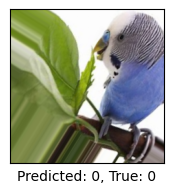

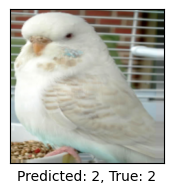

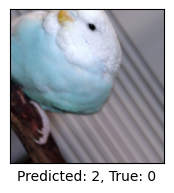

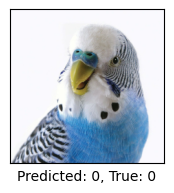

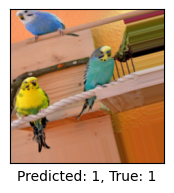

Confusion Matrix:
[[47  0  5  0  0]
 [ 0 39  0  3  0]
 [ 0  0 42  0  0]
 [ 0  0  0 34  1]
 [ 0  0  0  1 37]]
Accuracy: 0.9522
Precision: 0.9562
Recall: 0.9522
F1 Score: 0.9524
Loss: 0.005
Time: 4.2 sec


In [ ]:
train_fine_tuning(finetune_net, 5e-5, batch_size=batch_size, num_epochs=15)

## Run 7

In [ ]:
train_fine_tuning(finetune_net, 5e-5, batch_size=batch_size, num_epochs=10)

Epoch 1/10:
Confusion Matrix:
[[39 11  3  0  0]
 [ 4 33  0  1  2]
 [ 1  0 44  0  0]
 [ 2  9  0 24  0]
 [ 1  0  0  0 38]]
Accuracy: 0.8396
Precision: 0.8569
Recall: 0.8396
F1 Score: 0.8410
Loss: 1.037
Time: 2.0 sec
Epoch 2/10:
Confusion Matrix:
[[44  7  1  1  0]
 [ 2 34  0  4  0]
 [ 0  0 45  0  0]
 [ 1  4  0 30  0]
 [ 0  0  0  0 39]]
Accuracy: 0.9057
Precision: 0.9097
Recall: 0.9057
F1 Score: 0.9063
Loss: 0.144
Time: 2.1 sec
Epoch 3/10:
Confusion Matrix:
[[50  2  1  0  0]
 [ 1 34  0  4  1]
 [ 0  0 45  0  0]
 [ 1  5  0 29  0]
 [ 0  0  0  0 39]]
Accuracy: 0.9292
Precision: 0.9289
Recall: 0.9292
F1 Score: 0.9289
Loss: 0.049
Time: 2.1 sec
Epoch 4/10:
Confusion Matrix:
[[51  1  1  0  0]
 [ 0 34  0  5  1]
 [ 0  0 45  0  0]
 [ 1  4  0 30  0]
 [ 0  0  0  0 39]]
Accuracy: 0.9387
Precision: 0.9382
Recall: 0.9387
F1 Score: 0.9383
Loss: 0.031
Time: 2.0 sec
Epoch 5/10:
Confusion Matrix:
[[50  2  1  0  0]
 [ 1 34  0  4  1]
 [ 0  0 45  0  0]
 [ 1  4  0 30  0]
 [ 0  0  0  0 39]]
Accuracy: 0.9340
Precis